# Explainable AI for Text Classification

## 1) Problem Statement
In this notebook, we study a multi-class text classification problem.

The objective is to automatically assign a news post to one of several topic categories based solely on its textual content.

Formally:
* Input: A raw text document (free-form news post)
* Output: A discrete class label representing the topic

This is a supervised learning problem where we learn a function that maps a text to a corresponding topic (or class).

We will:
* Train two different classification models
* Treat them as black-box predictors
* Apply post-hoc Explainable AI (XAI) techniques
* Analyze both local explanations (per document) and global explanations (model-wide behavior)
* The central question we want to answer is:
* Why does the model predict a particular topic for a given document, and what linguistic patterns does it rely on overall?

## 2) Dataset
We use the 20 Newsgroups dataset, a well-known benchmark for text classification.

Dataset Characteristics:
* ~20,000 documents
* 20 topic categories
* Collected from public online discussion forums (Usenet)

For this tutorial, we may restrict to a subset of categories to:
* Reduce runtime
* Increase interpretability
* Make explanations clearer
  
Each document consists of:
* Free-form text
* Informal language
* Domain-specific vocabulary
* Potential noise (quotes, signatures, metadata)

This dataset is well-suited for XAI demonstrations because:
* It contains clear topical keywords
* Models often rely heavily on lexical signals
* Explanations are interpretable at the token level


## 3) Modeling Approach
We will:
1. Convert raw text into numerical representations using TF-IDF
2. Train two classifiers:
    * Linear Support Vector Machine (SVM)
    * Multi-Layer Perceptron (MLP)
3. Treat both models as black boxes
4. Apply post-hoc explainability techniques:
    * LIME (local explanations) & how to calculate Global-ish explanations from LIME
    * SHAP (local and global explanations, per class)
  
## ? Key Questions We Will Explore ...
* Which words strongly influence predictions?
* Do different models rely on similar tokens?
* Are predictions driven by intuitive domain keywords?
* Are there spurious correlations?

# Install 

In [ ]:
!pip install lime

In [ ]:
!pip -q install shap

# Imports

In [1]:
import re
import numpy as np
import pandas as pd

from sklearn.datasets import fetch_20newsgroups
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import (
    accuracy_score, f1_score, classification_report,
    ConfusionMatrixDisplay
)

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_selection import chi2

import matplotlib.pyplot as plt

# Parameter Initialization

In [2]:
RANDOM_STATE = 42
np.random.seed(RANDOM_STATE)

# Set CATEGORIES = None to use all 20 categories (slower, harder).
CATEGORIES = [
    "comp.graphics",
    "sci.space",
    "rec.sport.hockey",
    "talk.politics.mideast",
]

We chose the above categories because they clearly distinguish domains:
* Technical computing
* Sports
* Science
* Politics

What we expect from the XAI is to highlight intuitive tokens:
* e.g., graphics → "image", "file", "3d"
* e.g., hockey → "nhl", "game", "team"
* e.g., space → "orbit", "moon", "nasa"
* e.g., politics → "israel", "war", "government"

**QUESTION: <font color='green'>What are all the Categories?</font>**


In [3]:
all_train = fetch_20newsgroups(subset="train")

all_categories = all_train.target_names

print(f"Total number of categories: {len(all_categories)}\n")
print("All available categories:\n")

for i, cat in enumerate(all_categories):
    print(f"{i:2d}: {cat}")

Total number of categories: 20

All available categories:

 0: alt.atheism
 1: comp.graphics
 2: comp.os.ms-windows.misc
 3: comp.sys.ibm.pc.hardware
 4: comp.sys.mac.hardware
 5: comp.windows.x
 6: misc.forsale
 7: rec.autos
 8: rec.motorcycles
 9: rec.sport.baseball
10: rec.sport.hockey
11: sci.crypt
12: sci.electronics
13: sci.med
14: sci.space
15: soc.religion.christian
16: talk.politics.guns
17: talk.politics.mideast
18: talk.politics.misc
19: talk.religion.misc


In [4]:
del all_train
del all_categories

# Load data

In [5]:
# Remove headers/footers/quotes to avoid "shortcut" features (email signatures, quoting, etc.)
remove = ("headers", "footers", "quotes")

train_raw = fetch_20newsgroups(subset="train", categories=CATEGORIES, remove=remove)
test_raw  = fetch_20newsgroups(subset="test",  categories=CATEGORIES, remove=remove)

target_names = train_raw.target_names

print("Classes:", target_names)
print("Train size:", len(train_raw.data))
print("Test size:", len(test_raw.data))

Classes: ['comp.graphics', 'rec.sport.hockey', 'sci.space', 'talk.politics.mideast']
Train size: 2341
Test size: 1558


In [6]:
# Put into a DataFrame for easier exploration
df_train = pd.DataFrame({
    "text": train_raw.data,
    "label": train_raw.target,
    "label_name": [target_names[i] for i in train_raw.target]
})

df_test = pd.DataFrame({
    "text": test_raw.data,
    "label": test_raw.target,
    "label_name": [target_names[i] for i in test_raw.target]
})

df_train.head()

,text,label,label_name
0,: 8~> I require BGI drivers for Super VGA Disp...,0,comp.graphics
1,"\tAll humans suffered emotionally, some Jews a...",3,talk.politics.mideast
2,\n\nSo was it on CNN or not? \n\n\n\nWhat proo...,3,talk.politics.mideast
3,\tAre people here stupid or what??? It is a ti...,1,rec.sport.hockey
4,"Hello,\n\n I have been searching for a qual...",0,comp.graphics


# Exploratory Analysis

**QUESTION: <font color='green'>Is our dataset balanced?</font>**

In [7]:
def basic_text_stats(s: str) -> dict:
    s = s or ""
    chars = len(s)
    words = len(re.findall(r"\b\w+\b", s))
    lines = s.count("\n") + 1 if s else 0
    return {"chars": chars, "words": words, "lines": lines}

In [8]:
stats = df_train["text"].apply(basic_text_stats).apply(pd.Series)
df_train_stats = pd.concat([df_train, stats], axis=1)

# Class balance
class_counts = df_train_stats["label_name"].value_counts()
display(class_counts.to_frame("count"))

,count
label_name,
rec.sport.hockey,600
sci.space,593
comp.graphics,584
talk.politics.mideast,564


**Answer: <font color='blue'>YES! The dataset is approximately balanced across the four selected categories, reducing the risk of class-prior bias.</font>**

**QUESTION: <font color='green'>How is the Dataset's Length Distribution (chars, words, lines)</font>**

Why length matters for modeling?
1. TF-IDF normalization
    * Longer documents don’t automatically dominate.
    * But they may contain more class-specific keywords.
2. Explainability
    * Long documents → more tokens → more SHAP perturbations → slower runtime.
    * Short documents → fewer explanatory signals.
3. Model robustness
    * If one class has systematically longer documents, that becomes a hidden feature.

In [9]:
# Length distributions
display(df_train_stats[["chars", "words", "lines"]].describe())

,chars,words,lines
count,2341.000000,2341.000000,2341.000000
mean,1409.674071,235.718496,31.809483
std,4228.910978,706.206283,88.164044
min,0.000000,0.000000,0.000000
25%,237.000000,42.000000,7.000000
50%,487.000000,85.000000,12.000000
75%,1067.000000,183.000000,25.000000
max,74878.000000,11683.000000,1764.000000


**Answer: <font color='blue'>The dataset is highly right-skewed (mean >> median).</font>**

There are some extremely long documents pulling the mean upward.
but this is typical for forum data, some posts are short replies and some are long essays or quoted threads.

Also, notice that we have min 0 - this is because we removed =("headers", "footers", "quotes")

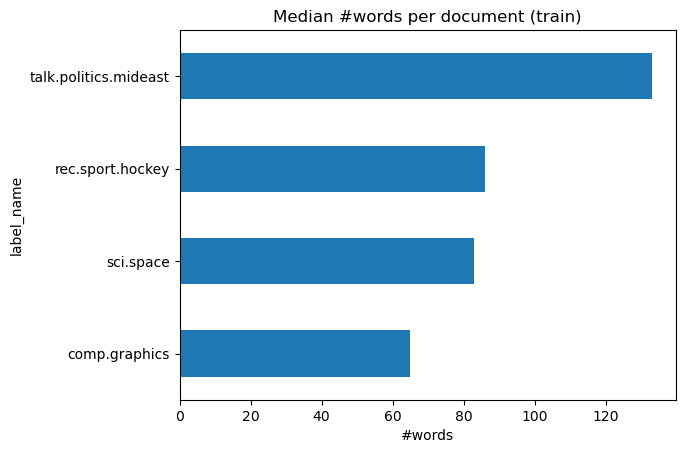

In [10]:
# Plot word count per class (median)
medians = df_train_stats.groupby("label_name")["words"].median().sort_values()
ax = medians.plot(kind="barh")
ax.set_title("Median #words per document (train)")
ax.set_xlabel("#words")
plt.show()

**-->** Political discussions are longer and more argumentative, as well as more essay-like

**-->** Graphics posts on the other hand, are more technical questions and often short problem descriptions

**-->** Regarding Hockey and Space, it is mixed (schedules, short updates, some long discussions)


**so what could happen? Potential length bias: If one class has systematically longer documents, the model might learn length-related patterns.**




**Below we inspect some examples:  <font color='green'>But why is inspecting raw examples crucial?</font>**

Before training any model, you should know whether the dataset contains noise (email headers, addresses), or if some posts are extremely short/long, some might include emotionally charged content. Vocabulary is domain-specific. This sets expectations for XAI output:
* We expect the model to rely heavily on domain-specific tokens like "orbit", "NHL", "file", "Israel".

In [11]:
# Inspect a few examples per class (helps set expectations + highlight noise)
for cls in target_names:
    print("\n" + "="*80)
    print("Class:", cls)
    sample = df_train_stats[df_train_stats["label_name"] == cls].sample(2, random_state=RANDOM_STATE)
    for i, row in sample.iterrows():
        preview = row["text"].strip().replace("\n", " ")
        print(f"\n--- Example (words={row['words']}) ---")
        print(preview[:600] + ("..." if len(preview) > 600 else ""))


Class: comp.graphics

--- Example (words=109) ---
Hi,  I've noticed that if you only save a model (with all your mapping planes positioned carefully) to a .3DS file that when you reload it after restarting 3DS, they are given a default position and orientation.  But if you save to a .PRJ file their positions/orientation are preserved.  Does anyone know why this information is not stored in the .3DS file?  Nothing is explicitly said in the manual about saving texture rules in the .PRJ file.  I'd like to be able to read the texture rule information, does anyone have  the format for the .PRJ file?  Is the .CEL file format available from somewher...

--- Example (words=15) ---
--   |||||||||||   		 	   |||||||||||  _|||||||||||_______________________|||||||||||_      jr0930@eve.albany.edu -|||||||||||-----------------------|||||||||||-     jr0930@Albnyvms.bitnet  |||||||||||  GO HEAVY OR GO HOME  |||||||||||

Class: rec.sport.hockey

--- Example (words=80) ---
United States TV Schedule: A

# Feature Preprocessing

**Before training complex models, we examine which words are statistically associated with each class. This gives us a model-agnostic baseline for what we expect explanations to highlight later.**


**<font color='green'>Bag of Words:</font>** This converts raw text into a Bag-of-Words (BoW) representation. Each document becomes a vector where each dimension corresponds to a word or bigram and its value is the number of times it appears in the document (Text → Numeric feature matrix)

Parameters: 
* lowercase=True --> “Game” and “game” are treated the same, which reduces artificial feature duplication
* stop_words="english" --> Removes common words like: “the”, “and”, “is”, “to” (because of their high frequency and low semantic values)
* min_df=5 --> Only keep words that appear in at least 5 documents. (to remove typos, reduce noise & hopefully improve interpretability)
* ngram_range=(1, 2) --> Includes Unigrams (e.g., “space”) and Bigrams (e.g., “space shuttle”)
    * Some concepts are multi-word expressions. Bigrams often improve topic separability. 


In [12]:
# bag-of-words
probe_vectorizer = CountVectorizer(
    lowercase=True,
    stop_words="english",
    min_df=5,           # ignore extremely rare words
    ngram_range=(1, 2)  # unigrams + bigrams
)

X_probe = probe_vectorizer.fit_transform(df_train["text"])
y_probe = df_train["label"].values
feature_names = np.array(probe_vectorizer.get_feature_names_out())

**<font color='green'>chi-square score:</font>** For each class, we temporarily treat the task as a one-vs-rest binary problem (that class versus all others) and compute the chi-square statistic for every token; this measures how strongly the presence of a word is associated with the class, where a high chi-square score indicates that the word appears disproportionately often in that class and is therefore statistically discriminative—an appropriate choice here because chi-square works well with non-negative bag-of-words counts, captures statistical dependence between features and labels, and is both computationally efficient and easy to interpret.

In [13]:
def top_chi2_terms_for_class(class_id: int, top_k: int = 15):
    # chi2 expects non-negative features ... CountVectorizer is fine
    chi2_scores, pvals = chi2(X_probe, (y_probe == class_id).astype(int))
    top_idx = np.argsort(chi2_scores)[::-1][:top_k]
    return list(zip(feature_names[top_idx], chi2_scores[top_idx]))

In [14]:
for cid, cname in enumerate(target_names):
    print("\n" + "-"*80)
    print("Most class-distinctive terms (chi²) for:", cname)
    for term, score in top_chi2_terms_for_class(cid, top_k=12):
        print(f"{term:<30} chi2={score:,.1f}")


--------------------------------------------------------------------------------
Most class-distinctive terms (chi²) for: comp.graphics
image                          chi2=1,280.6
graphics                       chi2=1,213.7
jpeg                           chi2=788.4
file                           chi2=636.2
files                          chi2=455.6
color                          chi2=446.4
format                         chi2=430.5
3d                             chi2=425.3
images                         chi2=372.1
software                       chi2=339.6
package                        chi2=339.0
ftp                            chi2=331.9

--------------------------------------------------------------------------------
Most class-distinctive terms (chi²) for: rec.sport.hockey
team                           chi2=1,158.9
game                           chi2=1,147.5
hockey                         chi2=1,054.2
55                             chi2=925.4
play                           chi2=907.4

For each class, chi-square identified the most statistically discriminative tokens. These are the words whose presence is most strongly associated with that class compared to the others.

**These are the words that best “separate” the class from the rest.**

### Leakage Detection (Emails, URLs)

In [15]:
# identify potential "leakage" tokens (emails, URLs) to discuss limitations
def leakage_ratio(text: str) -> dict:
    text = text or ""
    has_email = bool(re.search(r"\b[\w\.-]+@[\w\.-]+\.\w+\b", text))
    has_url = bool(re.search(r"https?://|www\.", text))
    return {"has_email": has_email, "has_url": has_url}

leak = df_train["text"].apply(leakage_ratio).apply(pd.Series)
print("Docs with emails:", leak["has_email"].mean())
print("Docs with URLs:", leak["has_url"].mean())

Docs with emails: 0.1294318667236224
Docs with URLs: 0.0


# Train test Split

In [17]:
X_train, y_train = df_train["text"].values, df_train["label"].values
X_test,  y_test  = df_test["text"].values,  df_test["label"].values

# Model Training

In [18]:
from sklearn.svm import LinearSVC
from sklearn.neural_network import MLPClassifier

In [19]:
tfidf = TfidfVectorizer(
    lowercase=True,
    stop_words="english",
    min_df=3,
    max_df=0.9,
    ngram_range=(1, 2),
)

model_svm = Pipeline([
    ("tfidf", tfidf),
    ("clf", LinearSVC())
])

model_mlp = Pipeline([
    ("tfidf", tfidf),
    ("clf", MLPClassifier(
        hidden_layer_sizes=(256,),
        activation="relu",
        alpha=1e-4,
        max_iter=15,         # keep short for tutorial; increase for better results
        random_state=RANDOM_STATE
    ))
])

print("Training SVM...")
model_svm.fit(X_train, y_train)

print("Training MLP...")
model_mlp.fit(X_train, y_train)

Training SVM...


/gpfs/opt/sw/jupyterhub/envs/conda/vsc5/jupyterhub-huggingface-v2/lib/python3.10/site-packages/sklearn/svm/_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


Training MLP...


/gpfs/opt/sw/jupyterhub/envs/conda/vsc5/jupyterhub-huggingface-v2/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (15) reached and the optimization hasn't converged yet.
  warnings.warn(


Pipeline(steps=[('tfidf',
                 TfidfVectorizer(max_df=0.9, min_df=3, ngram_range=(1, 2),
                                 stop_words='english')),
                ('clf',
                 MLPClassifier(hidden_layer_sizes=(256,), max_iter=15,
                               random_state=42))])

# Evaluate


LinearSVC + TF-IDF | accuracy=0.907 | macroF1=0.907
                       precision    recall  f1-score   support

        comp.graphics      0.909     0.897     0.903       389
     rec.sport.hockey      0.943     0.917     0.930       399
            sci.space      0.848     0.891     0.869       394
talk.politics.mideast      0.933     0.923     0.928       376

             accuracy                          0.907      1558
            macro avg      0.908     0.907     0.907      1558
         weighted avg      0.908     0.907     0.907      1558



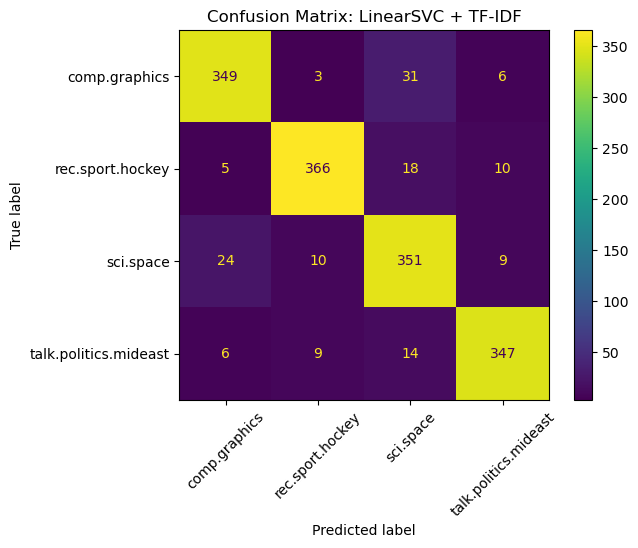


MLP + TF-IDF | accuracy=0.914 | macroF1=0.914
                       precision    recall  f1-score   support

        comp.graphics      0.939     0.913     0.926       389
     rec.sport.hockey      0.888     0.957     0.922       399
            sci.space      0.894     0.860     0.877       394
talk.politics.mideast      0.938     0.926     0.932       376

             accuracy                          0.914      1558
            macro avg      0.915     0.914     0.914      1558
         weighted avg      0.915     0.914     0.914      1558



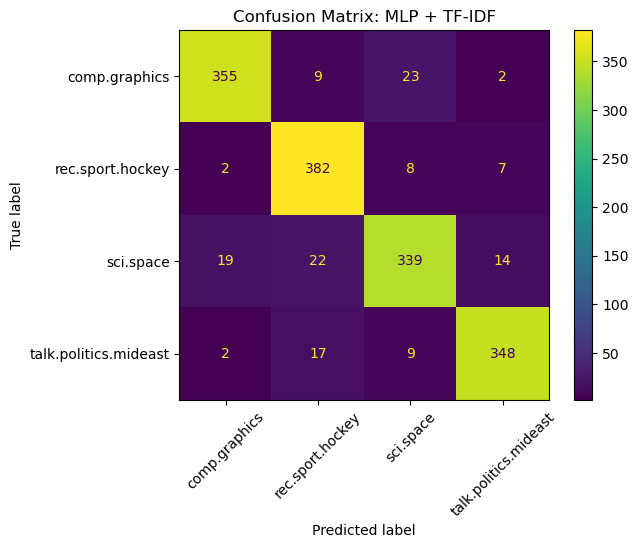

In [20]:
def evaluate(model, name: str):
    y_pred = model.predict(X_test)
    acc = accuracy_score(y_test, y_pred)
    f1m = f1_score(y_test, y_pred, average="macro")
    print(f"\n{name} | accuracy={acc:.3f} | macroF1={f1m:.3f}")
    print(classification_report(y_test, y_pred, target_names=target_names, digits=3))
    ConfusionMatrixDisplay.from_predictions(
        y_test, y_pred, display_labels=target_names, xticks_rotation=45
    )
    plt.title(f"Confusion Matrix: {name}")
    plt.show()

evaluate(model_svm, "LinearSVC + TF-IDF")
evaluate(model_mlp, "MLP + TF-IDF")

Both linear and neural models achieve high performance (~91% accuracy), indicating strong lexical separability between classes. The small performance gap suggests that complex nonlinear modeling provides limited additional benefit for this topic classification task.

# Explainability

## LIME
### Local Explanations

In [21]:
from lime.lime_text import LimeTextExplainer

In [22]:
# initiate an explainer
explainer = LimeTextExplainer(class_names=target_names)

In [23]:
from scipy.special import softmax

In [24]:
def predict_proba_like(model, texts):
    # model is a Pipeline
    clf = model.named_steps["clf"]
    if hasattr(clf, "predict_proba"):
        return model.predict_proba(texts)
    # fallback for margin-based models (e.g., LinearSVC)
    scores = model.decision_function(texts)
    # decision_function can return shape (n_samples,) for binary; normalize to (n,2)
    if scores.ndim == 1:
        scores = np.vstack([-scores, scores]).T
    return softmax(scores, axis=1)

In [25]:
# Pick a test example to explain
idx = 0
text_to_explain = X_test[idx]
true_label = y_test[idx]
print("TRUE:", target_names[true_label])
print("TEXT PREVIEW:", text_to_explain[:400].replace("\n", " ") + "...")

TRUE: talk.politics.mideast
TEXT PREVIEW:   You don't get it - do you? During the years of World War I, the x-Soviet  Armenian Government has planned and perpetrated the 'Genocide' of the  Muslim people, which not only took the lives of 2.5 million Muslim people,  but was also the method used to empty the Turkish homeland of its inhabitants.  To this day, Turkish historic lands remain occupied by the x-Soviet Armenia.  In order to cover u...


In [27]:
exp_svm = explainer.explain_instance(
    text_to_explain,
    classifier_fn=lambda x: predict_proba_like(model_svm, x),
    num_features=12,
    labels=(3,)
)
print("\nSVM predicted:", target_names[int(np.argmax(predict_proba_like(model_svm, [text_to_explain])[0]))])
exp_svm.show_in_notebook(text=True)


SVM predicted: talk.politics.mideast


In [28]:
exp_mlp = explainer.explain_instance(
    text_to_explain,
    classifier_fn=lambda x: predict_proba_like(model_mlp, x),
    num_features=12,
    labels=(3,)
)
print("\nMLP predicted:", target_names[int(np.argmax(predict_proba_like(model_mlp, [text_to_explain])[0]))])
exp_mlp.show_in_notebook(text=True)


MLP predicted: talk.politics.mideast


The LIME explanation (for index 0) highlights politically salient terms such as “Armenian”, “Muslim”, and “Government”, which strongly contribute to the model’s prediction of the talk.politics.mideast class. The explanation aligns with earlier chi-square analysis, suggesting that the model relies on intuitive domain-specific vocabulary.

In [32]:
idx = 4
text_to_explain = X_test[idx]
true_label = y_test[idx]
print("TRUE:", target_names[true_label])
print("TEXT PREVIEW:", text_to_explain[:400].replace("\n", " ") + "...")

TRUE: rec.sport.hockey
TEXT PREVIEW:    For those of you who read TV Guide, there's an article in next week's SPORTSVIEW concerning the NHL and major network broadcasting. Pretty interesting....


In [36]:
exp_mlp = explainer.explain_instance(
    text_to_explain,
    classifier_fn=lambda x: predict_proba_like(model_mlp, x),
    num_features=12,
    labels=(0,)
)

In [37]:
print("\nMLP predicted:", target_names[int(np.argmax(predict_proba_like(model_mlp, [text_to_explain])[0]))])
exp_mlp.show_in_notebook(text=True)


MLP predicted: comp.graphics


In [39]:
exp_svm = explainer.explain_instance(
    text_to_explain,
    classifier_fn=lambda x: predict_proba_like(model_svm, x),
    num_features=12,
    labels=(0,)
)
print("\nSVM predicted:", target_names[int(np.argmax(predict_proba_like(model_svm, [text_to_explain])[0]))])
exp_svm.show_in_notebook(text=True)


SVM predicted: comp.graphics


### Global explanations

In [40]:
from collections import Counter

In [41]:
def is_nontrivial_text(s: str, min_tokens: int = 3) -> bool:
    if s is None:
        return False
    s = str(s).strip()
    if not s:
        return False
    # simple token count (LIME's tokenization can differ, but this prevents doc_size=0 cases)
    tokens = re.findall(r"\b\w+\b", s)
    return len(tokens) >= min_tokens

def aggregate_lime_features_safe(model, X, n_samples=80, num_features=8, seed=42, min_tokens=3, num_samples_lime=2000):
    rng = np.random.default_rng(seed)

    # filter indices to only those with enough tokens
    valid_idxs = [i for i, txt in enumerate(X) if is_nontrivial_text(txt, min_tokens=min_tokens)]
    if len(valid_idxs) == 0:
        raise ValueError("No non-empty documents found after filtering.")

    chosen = rng.choice(valid_idxs, size=min(n_samples, len(valid_idxs)), replace=False)

    c = Counter()
    skipped = 0

    for i in chosen:
        try:
            exp = explainer.explain_instance(
                X[i],
                classifier_fn=lambda x: predict_proba_like(model, x),
                num_features=num_features,
                num_samples=num_samples_lime
            )
            for feat, w in exp.as_list():
                c[feat] += abs(w)
        except ValueError as e:
            # safety net: if LIME still fails on some weird tokenization edge case
            skipped += 1
            continue

    return c, {"chosen": len(chosen), "skipped": skipped, "valid_pool": len(valid_idxs)}

In [42]:
agg_svm, info_svm = aggregate_lime_features_safe(model_svm, X_test, n_samples=80, num_features=8, seed=RANDOM_STATE)
agg_mlp, info_mlp = aggregate_lime_features_safe(model_mlp, X_test, n_samples=80, num_features=8, seed=RANDOM_STATE)

print("SVM aggregation info:", info_svm)
print("MLP aggregation info:", info_mlp)

SVM aggregation info: {'chosen': 80, 'skipped': 0, 'valid_pool': 1518}
MLP aggregation info: {'chosen': 80, 'skipped': 0, 'valid_pool': 1518}


In [43]:
print("\nTop aggregated LIME features (SVM):")
for feat, score in agg_svm.most_common(15):
    print(f"{feat:<30} | agg_abs_weight={score:.3f}")


Top aggregated LIME features (SVM):
game                           | agg_abs_weight=0.968
hockey                         | agg_abs_weight=0.684
space                          | agg_abs_weight=0.532
play                           | agg_abs_weight=0.421
team                           | agg_abs_weight=0.359
games                          | agg_abs_weight=0.270
Israel                         | agg_abs_weight=0.245
file                           | agg_abs_weight=0.202
graphics                       | agg_abs_weight=0.170
player                         | agg_abs_weight=0.159
Roger                          | agg_abs_weight=0.155
Game                           | agg_abs_weight=0.154
image                          | agg_abs_weight=0.150
kill                           | agg_abs_weight=0.122
guess                          | agg_abs_weight=0.115


In [44]:
print("\nTop aggregated LIME features (MLP):")
for feat, score in agg_mlp.most_common(15):
    print(f"{feat:<30} | agg_abs_weight={score:.3f}")


Top aggregated LIME features (MLP):
space                          | agg_abs_weight=0.447
game                           | agg_abs_weight=0.392
games                          | agg_abs_weight=0.326
sci                            | agg_abs_weight=0.320
hockey                         | agg_abs_weight=0.308
play                           | agg_abs_weight=0.283
kill                           | agg_abs_weight=0.278
rec                            | agg_abs_weight=0.270
Mario                          | agg_abs_weight=0.257
Roger                          | agg_abs_weight=0.244
Rangers                        | agg_abs_weight=0.220
player                         | agg_abs_weight=0.209
Hmmm                           | agg_abs_weight=0.206
team                           | agg_abs_weight=0.203
nasa                           | agg_abs_weight=0.192


Aggregating local LIME explanations reveals that both models rely primarily on domain-specific keywords such as “game”, “space”, and “hockey”. The neural model additionally highlights stylistic or structural tokens (e.g., “sci”, “rec”, discourse markers), suggesting slightly broader feature utilization despite similar overall accuracy.

## SHAP
### Local Explainations

In [45]:
import shap

In [46]:
# Background corpus (small sample)
bg_size = 30
bg_idx = np.random.choice(len(X_train), size=bg_size, replace=False)
X_bg = X_train[bg_idx]

In [47]:
# Explain a few test docs
explain_n = 0
X_explain = X_test[:explain_n]

In [48]:
# SHAP needs a function that maps list[str] -> (n_samples, n_classes)
def f_proba_svm(texts):
    return predict_proba_like(model_svm, texts)

def f_proba_mlp(texts):
    return predict_proba_like(model_mlp, texts)

In [49]:
masker = shap.maskers.Text()  # default tokenization

In [50]:
explainer_svm = shap.Explainer(f_proba_svm, masker, output_names=target_names)
explainer_mlp = shap.Explainer(f_proba_mlp, masker, output_names=target_names)

#### explain a few documents:

In [51]:
# pick a few non-empty docs
X_explain = [t for t in X_test if str(t).strip()][:5]

shap_values_svm = explainer_svm(X_explain)
shap_values_mlp = explainer_mlp(X_explain)

# visualize first example
shap.plots.text(shap_values_svm[0])

In [53]:
shap.plots.text(shap_values_mlp[0])

#### only for the predicted class (SVM)

In [52]:
probs0 = f_proba_svm([X_explain[0]])[0]
pred_class = int(np.argmax(probs0))
print("Pred:", target_names[pred_class], " | probs:", np.round(probs0, 3))

shap.plots.text(shap_values_svm[0, :, pred_class])

Pred: talk.politics.mideast  | probs: [0.062 0.052 0.05  0.837]


#### only for the predicted class (MLP)

In [43]:
probs0 = f_proba_mlp([X_explain[0]])[0]
pred_class = int(np.argmax(probs0))
print("Pred:", target_names[pred_class], " | probs:", np.round(probs0, 3))

shap.plots.text(shap_values_mlp[0, :, pred_class])

Pred: talk.politics.mideast  | probs: [0. 0. 0. 1.]


Both the linear SVM and the MLP correctly classify the document as talk.politics.mideast. However, the SHAP explanations reveal subtle differences: the SVM distributes contributions more proportionally across key tokens, while the MLP produces a more saturated and uniformly strong positive signal, reflecting its sharper confidence. Despite these differences, both models rely on semantically meaningful geopolitical terms.

### Global Explanations
#### Overall token importance

In [54]:
from collections import defaultdict

In [55]:
# probability wrapper
def f_proba_svm(texts):
    return predict_proba_like(model_svm, texts)

In [56]:
masker = shap.maskers.Text()
explainer_svm = shap.Explainer(f_proba_svm, masker, output_names=target_names)

In [57]:
X_global = [t for t in X_test if str(t).strip()]
X_global = X_global[:200]  # keep small for speed
sv = explainer_svm(X_global)  # sv is a shap.Explanation

PartitionExplainer explainer: 201it [01:17,  1.94it/s]                         


In [58]:
# But token positions differ per sample, so we need to aggregate by token string:
imp = defaultdict(list)

for i in range(len(X_global)):
    tokens = sv.data[i]               # list of tokens for sample i
    vals_i = np.abs(sv.values[i]).mean(axis=1)  # mean over classes -> (n_tokens,)
    for tok, v in zip(tokens, vals_i):
        tok = tok.strip()
        if tok:
            imp[tok].append(float(v))

global_tok = sorted(((t, np.mean(vs)) for t, vs in imp.items()),
                    key=lambda x: x[1], reverse=True)

print("Top global tokens by mean(|SHAP|) across classes:")
for t, v in global_tok[:30]:
    print(f"{t!r:>12}  {v:.4f}")

Top global tokens by mean(|SHAP|) across classes:
  'team....'  0.1197
     'stats'  0.0925
   'Israel/'  0.0831
      'Nick'  0.0772
     'moon.'  0.0760
     'team"'  0.0735
     'dis |'  0.0725
     'lunar'  0.0711
     'puck.'  0.0696
      'card'  0.0692
     'data?'  0.0654
   "Roger?'"  0.0645
 'graphics.'  0.0644
     'file.'  0.0633
       'Hi,'  0.0627
     'game?'  0.0621
        'Hi'  0.0603
'Presumably'  0.0581
  'Graphics'  0.0550
      'Gee,'  0.0547
       'vga'  0.0542
      'moon'  0.0540
    'site ('  0.0534
   'correct'  0.0532
     'game;'  0.0531
    'space.'  0.0523
     "NASA'"  0.0522
     'fans.'  0.0502
   'hockey.'  0.0501
    'Flyers'  0.0500


#### Per-class “signature tokens”

In [49]:
# ---- 1) Helper: filter docs that won't break the text masker
def has_enough_tokens_for_shap(s: str, min_tokens: int = 10) -> bool:
    if s is None:
        return False
    s = str(s).strip()
    if not s:
        return False
    toks = re.findall(r"\b\w+\b", s)
    return len(toks) >= min_tokens


# ---- 2) Compute per-class global token importance
def shap_global_token_importance_per_class(
    sv,                    # SHAP Explanation for a batch of texts
    top_k: int = 20,
    aggregate: str = "mean_abs",  # "mean_abs" or "mean_pos"
):
    """
    Returns: dict[class_id] -> list[(token, score)] sorted desc

    Handles ragged token lengths:
      sv.data[i]   : array/list of tokens for doc i
      sv.values[i] : array (n_tokens,) OR (n_tokens, n_classes)
    """
    # Determine number of classes from the first element that has 2D values
    n_classes = None
    for i in range(len(sv.values)):
        v = np.asarray(sv.values[i])
        if v.ndim == 2:
            n_classes = v.shape[1]
            break
    if n_classes is None:
        raise ValueError(
            "sv.values does not contain per-class token attributions (no (n_tokens, n_classes) found). "
            "Make sure your explainer returns class-wise outputs (multiclass proba-like function)."
        )

    per_class_scores = [defaultdict(list) for _ in range(n_classes)]

    for i in range(len(sv.values)):
        toks = sv.data[i]
        v = np.asarray(sv.values[i])

        # Skip docs that are not per-class shaped
        if v.ndim != 2 or v.shape[1] != n_classes:
            continue

        for c in range(n_classes):
            vc = v[:, c]
            if aggregate == "mean_abs":
                contrib = np.abs(vc)
            elif aggregate == "mean_pos":
                contrib = vc  # later we keep only positive contributions
            else:
                raise ValueError("aggregate must be 'mean_abs' or 'mean_pos'")

            for tok, score in zip(toks, contrib):
                tok = str(tok).strip()
                if not tok:
                    continue
                if aggregate == "mean_pos" and score <= 0:
                    continue
                per_class_scores[c][tok].append(float(score))

    # Reduce lists -> means and sort
    results = {}
    for c in range(n_classes):
        items = [(t, float(np.mean(vs))) for t, vs in per_class_scores[c].items()]
        items.sort(key=lambda x: x[1], reverse=True)
        results[c] = items[:top_k]

    return results


# ---- 3) Pretty-print: class name on top
def print_token_importance_per_class(token_imp_by_class, class_names):
    for c, cname in enumerate(class_names):
        print("\n" + "=" * 90)
        print(f"CLASS: {cname}")
        print("=" * 90)
        for tok, score in token_imp_by_class.get(c, []):
            print(f"{tok!r:>14}  score={score:.5f}")



In [50]:
# 1) Pick a batch for global explanations (keep small for speed)
X_global = [t for t in X_test if has_enough_tokens_for_shap(t, min_tokens=10)]
X_global = X_global[:50]  # 30-50 recommended for tutorial runtime

# 2) Explain (bound compute)
sv = explainer_svm(X_global, max_evals=200, silent=True)

# 3) Compute per-class token importance
# Choose aggregation:
# - "mean_abs": tokens that matter most (magnitude), regardless of direction
# - "mean_pos": tokens that push TOWARD the class (positive contribution)
token_imp_by_class = shap_global_token_importance_per_class(
    sv,
    top_k=20,
    aggregate="mean_pos"   # try "mean_abs" if you want pure importance
)

# 4) Show results with class header
print_token_importance_per_class(token_imp_by_class, target_names)


CLASS: comp.graphics
        'TIFF'  score=0.10098
        'help'  score=0.08372
      'image.'  score=0.07070
         'Try'  score=0.06451
    'Graphics'  score=0.05940
      'Pretty'  score=0.05453
      'viewer'  score=0.05029
     'advance'  score=0.04349
    'graphics'  score=0.04260
      'author'  score=0.03847
        'code'  score=0.03813
        'pub/'  score=0.03620
      'Guide,'  score=0.03194
     'polygon'  score=0.03077
  'routines ('  score=0.03077
   'science -'  score=0.02799
         'GIF'  score=0.02607
         'Hi!'  score=0.02600
        'MAil'  score=0.02579
        'edu:'  score=0.02565

CLASS: rec.sport.hockey
        'team'  score=0.17737
       'game.'  score=0.16294
     'hockey.'  score=0.15784
      'hockey'  score=0.13939
        'fans'  score=0.10247
      'year ('  score=0.09254
       'fans.'  score=0.08025
         'NHL'  score=0.06700
        'ESPN'  score=0.06667
       'games'  score=0.06343
   'Canadiens'  score=0.06173
       'Wings'  score=0

#### SHAP beeswarm / summary plot


Class: comp.graphics | docs explained: 50 | docs with vocab hits: 44


/tmp/ipykernel_1513044/3429531774.py:105: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(


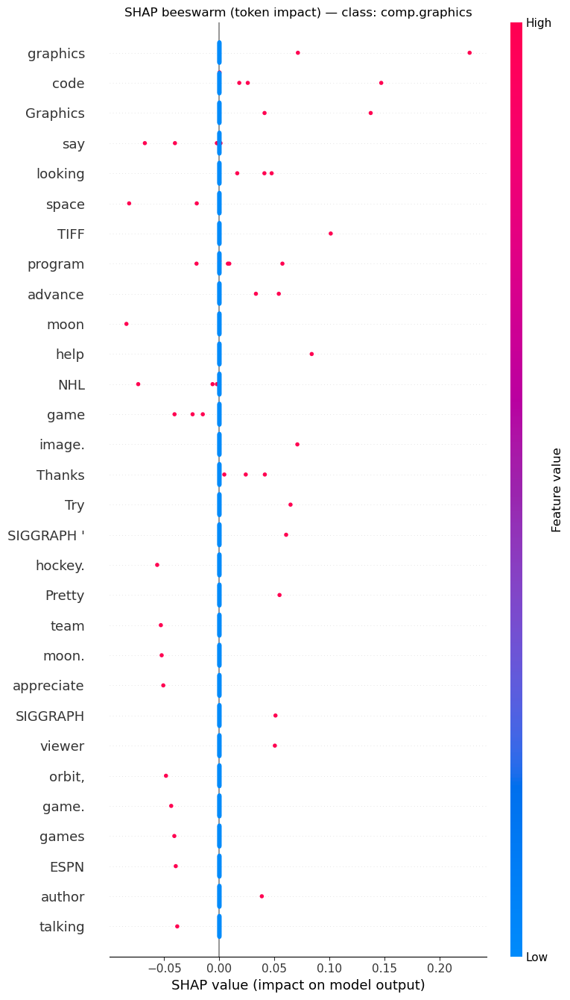


Class: rec.sport.hockey | docs explained: 50 | docs with vocab hits: 41


/tmp/ipykernel_1513044/3429531774.py:105: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(


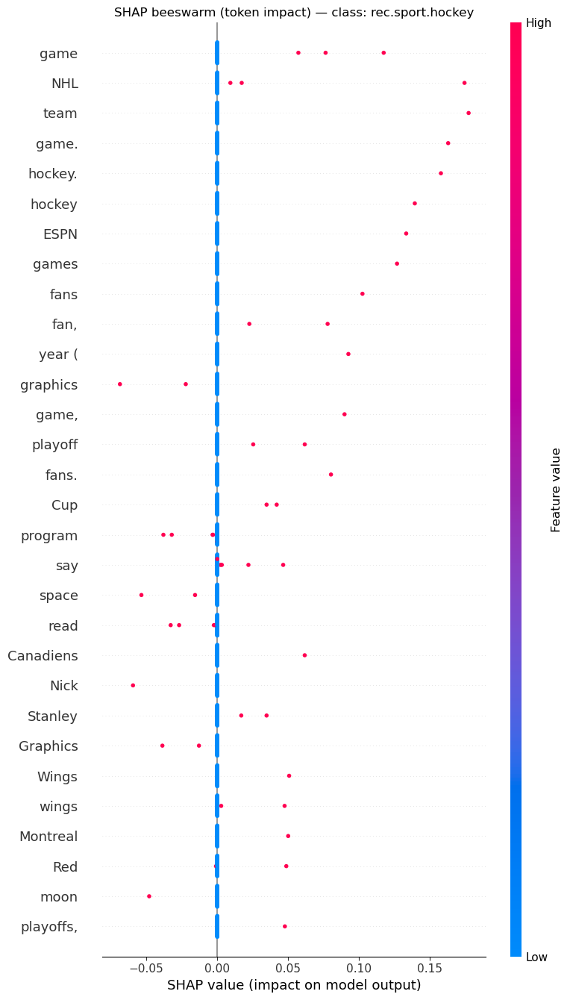


Class: sci.space | docs explained: 50 | docs with vocab hits: 47


/tmp/ipykernel_1513044/3429531774.py:105: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(


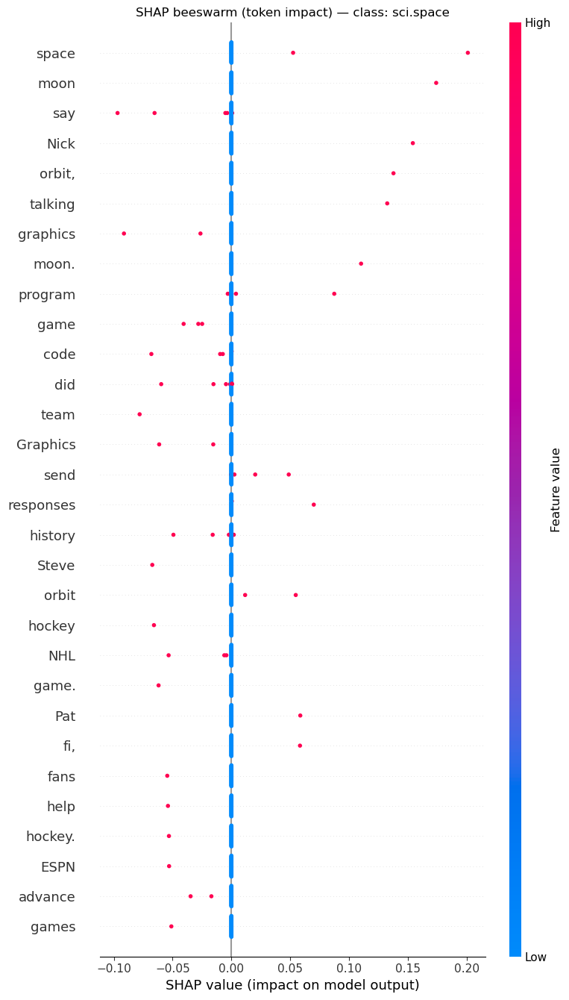


Class: talk.politics.mideast | docs explained: 50 | docs with vocab hits: 49


/tmp/ipykernel_1513044/3429531774.py:105: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(


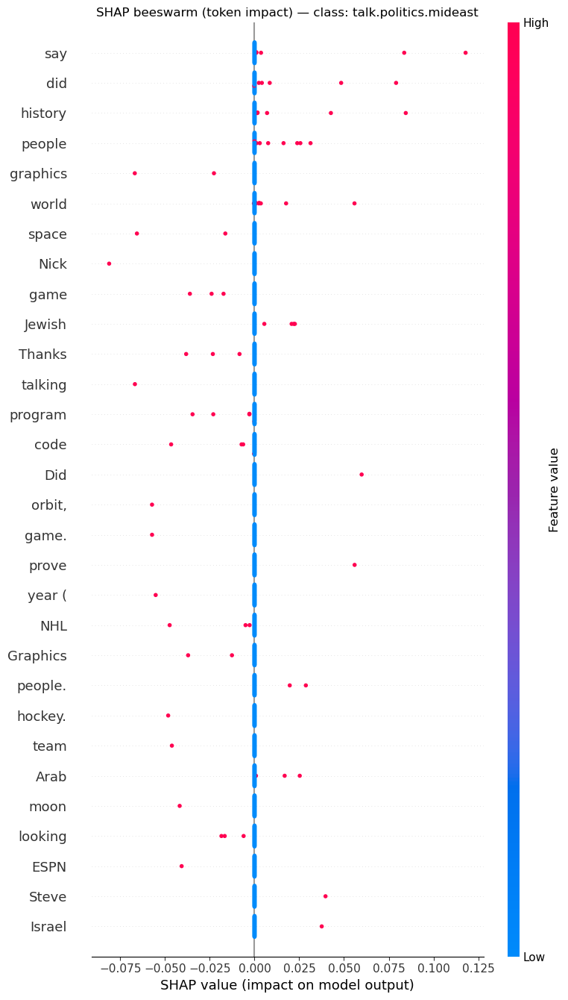

In [51]:
# ----------------------------
# 1) Choose a global sample + run SHAP ONCE
# ----------------------------
def has_enough_tokens_for_shap(s: str, min_tokens: int = 10) -> bool:
    import re
    if s is None:
        return False
    s = str(s).strip()
    if not s:
        return False
    toks = re.findall(r"\b\w+\b", s)
    return len(toks) >= min_tokens

X_global = [t for t in X_test if has_enough_tokens_for_shap(t, min_tokens=10)]
X_global = X_global[:50]  # increase if runtime allows

sv = explainer_svm(X_global, max_evals=200, silent=True)

# Determine number of classes from ragged per-doc values
n_classes = None
for i in range(len(sv.values)):
    v = np.asarray(sv.values[i])
    if v.ndim == 2:
        n_classes = v.shape[1]
        break
if n_classes is None:
    raise ValueError("Could not infer n_classes; sv.values never had shape (n_tokens, n_classes).")


# ----------------------------
# 2) Build per-class vocabulary from SHAP magnitudes
# ----------------------------
def build_top_vocab_for_class(sv, class_id: int, top_n: int = 100):
    token_scores = defaultdict(list)

    for i in range(len(sv.values)):
        toks = sv.data[i]
        v = np.asarray(sv.values[i])

        # Expect (n_tokens, n_classes)
        if v.ndim != 2 or v.shape[1] <= class_id:
            continue

        vals_c = v[:, class_id]
        for tok, score in zip(toks, np.abs(vals_c)):
            tok = str(tok).strip()
            if tok:
                token_scores[tok].append(float(score))

    ranked = sorted(
        ((t, float(np.mean(scores))) for t, scores in token_scores.items()),
        key=lambda x: x[1],
        reverse=True
    )
    vocab = [t for t, _ in ranked[:top_n]]
    return vocab


# ----------------------------
# 3) Build rectangular matrices for shap.summary_plot
# ----------------------------
def build_matrices_for_class(sv, class_id: int, vocab):
    tok2idx = {t: j for j, t in enumerate(vocab)}

    S = np.zeros((len(sv.values), len(vocab)), dtype=float)   # SHAP contributions
    Xv = np.zeros((len(sv.values), len(vocab)), dtype=float)  # feature values (presence)

    kept = 0
    for i in range(len(sv.values)):
        toks = [str(t).strip() for t in sv.data[i]]
        v = np.asarray(sv.values[i])

        if v.ndim != 2 or v.shape[1] <= class_id:
            continue

        vals_c = v[:, class_id]

        any_hit = False
        for tok, contrib in zip(toks, vals_c):
            if tok in tok2idx:
                j = tok2idx[tok]
                S[i, j] += float(contrib)
                Xv[i, j] = 1.0  # presence (use +=1.0 for counts)
                any_hit = True

        if any_hit:
            kept += 1

    return S, Xv, kept


# ----------------------------
# 4) Per-class beeswarm plots
# ----------------------------
TOP_N_VOCAB = 120     # tokens to include in the fixed vocab per class
MAX_DISPLAY = 30      # how many rows to show in the beeswarm

for c in range(n_classes):
    vocab_c = build_top_vocab_for_class(sv, c, top_n=TOP_N_VOCAB)
    S_c, Xv_c, kept = build_matrices_for_class(sv, c, vocab_c)

    print(f"\nClass: {target_names[c]} | docs explained: {len(X_global)} | docs with vocab hits: {kept}")

    plt.figure(figsize=(8, 10))
    shap.summary_plot(
        S_c,
        features=Xv_c,
        feature_names=vocab_c,
        plot_type="dot",      # beeswarm
        max_display=MAX_DISPLAY,
        show=False
    )
    plt.title(f"SHAP beeswarm (token impact) — class: {target_names[c]}")
    plt.tight_layout()
    plt.show()

# Conclusion

In this notebook, we analyzed a multi-class text classification problem using a subset of the 20 Newsgroups dataset and applied multiple explainability techniques to understand model behavior.

We observed that:

- The dataset is well-balanced and lexically separable.
- Domain-specific vocabulary strongly characterizes each topic.
- Both a linear SVM and a neural MLP achieve high performance (~91% accuracy).
- Statistical feature analysis (chi-square), LIME explanations, and SHAP explanations consistently highlight semantically meaningful tokens.

Across methods, the models rely primarily on intuitive, domain-relevant keywords such as:

- **“nasa”, “orbit”** for `sci.space`
- **“nhl”, “game”** for `rec.sport.hockey`
- **“jpeg”, “image”** for `comp.graphics`
- **“armenian”, “turkish”** for `talk.politics.mideast`

This consistency increases confidence that the models are learning topic semantics rather than spurious correlations.

---

## From Statistical Association to Model Explanation

Interpretability was built in layers:

1. **Chi-square analysis** — model-free identification of statistically discriminative terms.
2. **LIME** — local surrogate explanations for individual predictions.
3. **SHAP** — additive, theoretically grounded feature attributions.
4. **Global aggregation** — combining local explanations to approximate global model behavior.

The strong alignment across these methods suggests that this task is largely keyword-driven and that model decisions are semantically coherent.

---

## Limitations Revealed by XAI

Explainability also surfaced important considerations:

- Presence of metadata artifacts (e.g., email addresses).
- Strong reliance on identity-related terms in political content.
- Potential stylistic or structural cues influencing the neural model.
- Highly confident predictions indicating sharp decision boundaries.

This reinforces a key principle:

> Explainability does not prove correctness — it reveals model behavior.

Understanding behavior is a prerequisite for responsible deployment.

---

## Real-World Use Case Perspective

Text classification systems are widely used in:

- Content moderation
- News and document categorization
- Email filtering
- Legal and compliance screening
- Social media monitoring
- Political content analysis

In many of these applications:

- Decisions may impact visibility, access, or public discourse.
- Sensitive identity-related language may be involved.
- Bias or unintended correlations can have serious consequences.

Explainability enables us to:

- Audit model decisions.
- Detect reliance on sensitive or spurious features.
- Increase transparency and stakeholder trust.
- Diagnose weaknesses before deployment.

For example, if a political classifier disproportionately relies on identity terms, explainability can reveal this pattern early and inform mitigation strategies.

---

## Key Takeaways

- Linear models remain highly competitive for topic classification.
- Post-hoc XAI methods provide meaningful insight into model decisions.
- Aggregated local explanations approximate global understanding.
- Model architecture influences explanation structure.
- Explainability is essential for trustworthy AI systems.

---
